In [43]:
import warnings
import scanpy as sc
import squidpy as sq
import anndata as an
import pandas as pd
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns
from urllib import request
import scanorama
import json
import os

sc.settings.set_figure_params(dpi=80)
# sc.set_figure_params(facecolor="white", figsize=(8, 8))
warnings.simplefilter(action='ignore', category=FutureWarning)
sc.settings.verbosity = 3

# Глобальное окружение

## Подгрузим данные

In [52]:
adata = sc.read_h5ad('results/spatial_transcriptomics/human.h5ad')
adata

C:\Users\aleks\anaconda3\envs\scanorama39\lib\site-packages\anndata\_core\anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


AnnData object with n_obs × n_vars = 17663 × 19966
    obs: 'in_tissue', 'array_row', 'array_col', 'label', 'sample_id'
    var: 'gene_ids', 'feature_types', 'genome'
    uns: 'spatial'
    obsm: 'spatial'

## Глобальные переменные

In [3]:
samples = adata.uns['spatial'].keys()
samples

dict_keys(['human_759', 'human_j12', 'human_j3', 'human_j4', 'human_j6'])

# QC

## Посмотрим на изображения

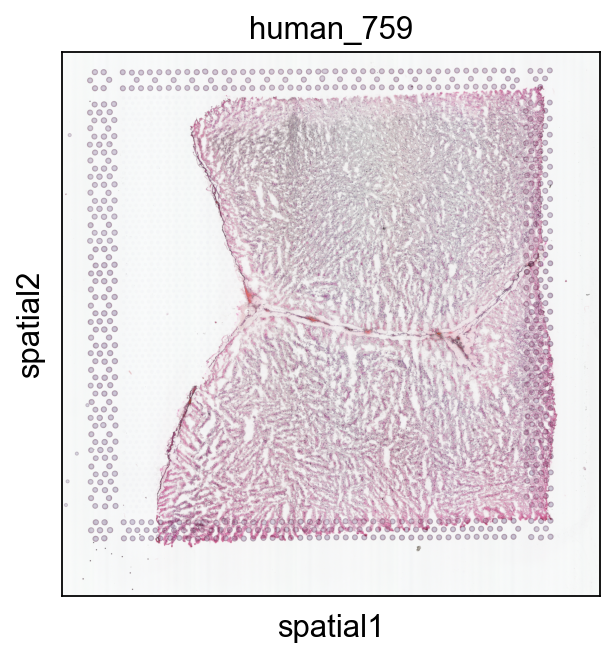

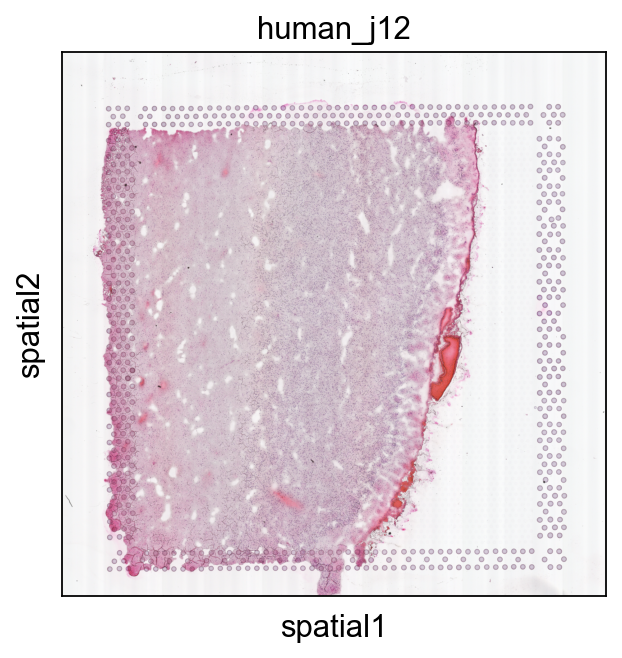

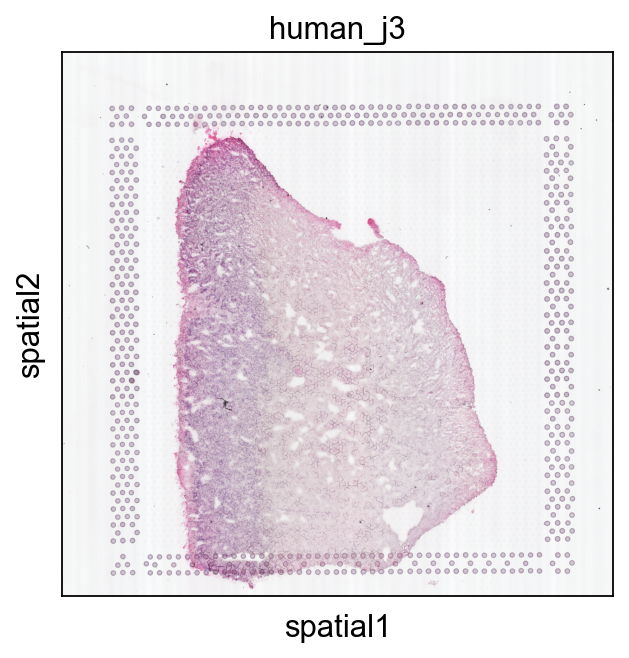

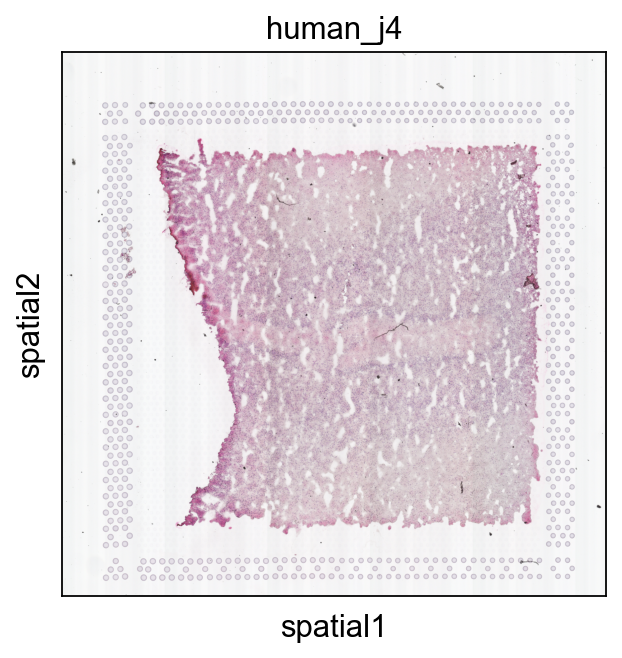

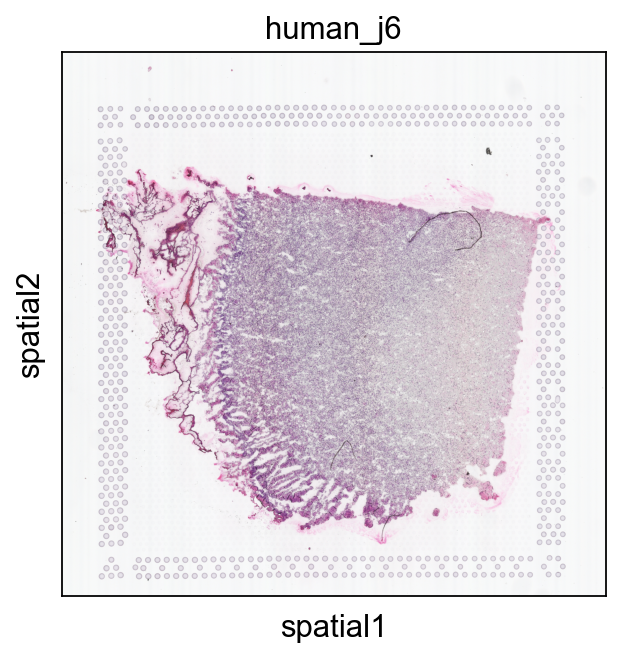

In [4]:
for sample in samples:
    sq.pl.spatial_scatter(adata, library_id=sample, title=sample)

## Посмотрим на экспрессию митохондриальных, гемоглобиновых и рибосомных генов

### Посчитаем метрики

In [20]:
qc_metrics = sc.pp.calculate_qc_metrics(
    adata, qc_vars=['mt','hb','ribo'],
    percent_top=None, log1p=False, inplace=False)

In [5]:
# add info on mitochondrial and hemoglobin genes to the objects.
adata.var['mt'] = adata.var_names.str.startswith('MT-')
adata.var['hb'] = adata.var_names.str.contains(("^HB[AB]"))
adata.var['ribo'] = adata.var_names.str.contains(("^RP[LS]"))

sc.pp.calculate_qc_metrics(
    adata, qc_vars=['mt','hb','ribo'],
    percent_top=None, log1p=False, inplace=True)

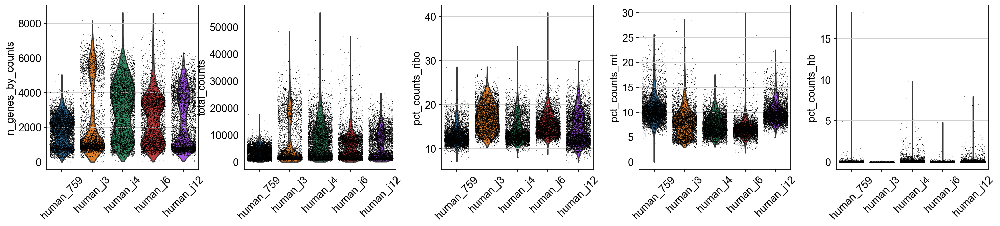

In [6]:
sc.pl.violin(adata,
             keys = ['n_genes_by_counts', 'total_counts','pct_counts_ribo',
                     'pct_counts_mt', 'pct_counts_hb'],
             jitter=0.4, groupby = 'sample_id', rotation= 45, save='qc.png')

Заметим значительный уровень экспрессии митохондриальных генов

### Посмотрим на пространственное распределение 

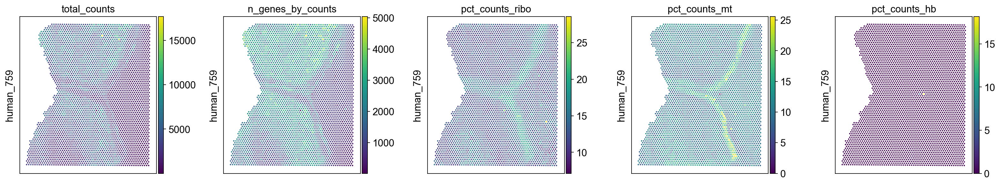

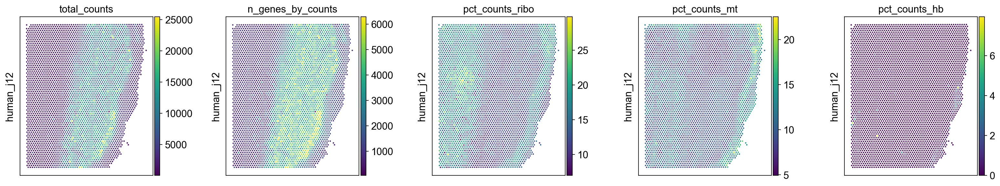

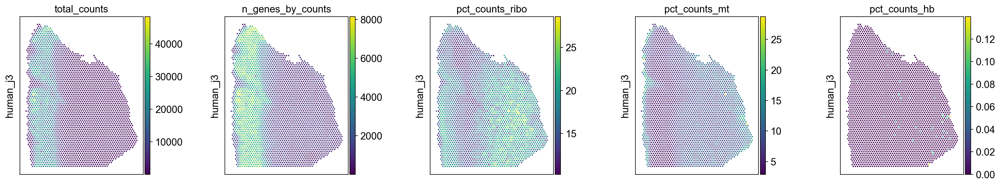

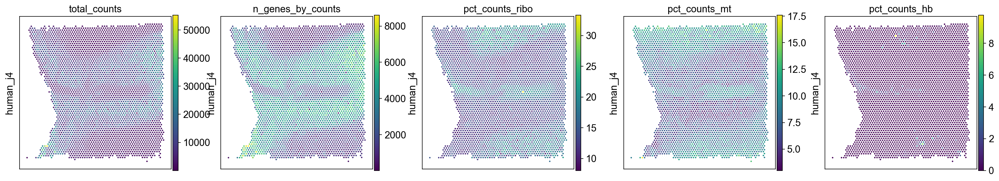

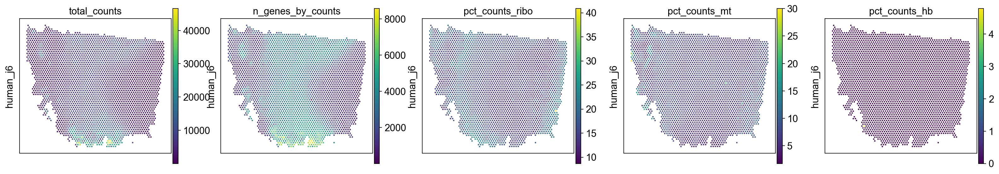

In [7]:
for sample in samples:
    sq.pl.spatial_scatter(adata, library_id=sample, color = [
            'total_counts', 'n_genes_by_counts','pct_counts_ribo',
            'pct_counts_mt', 'pct_counts_hb'], ncols=5, library_key='sample_id',
        img=False, axis_label=['', sample])

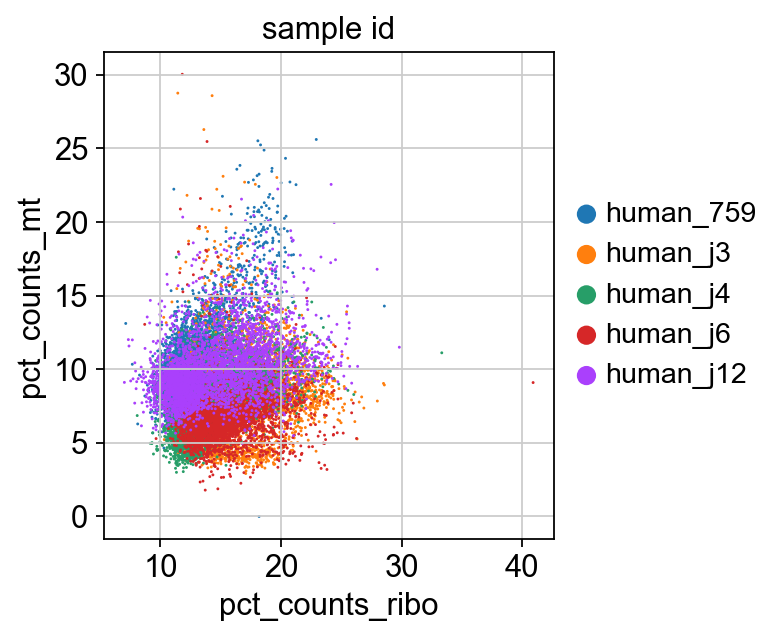

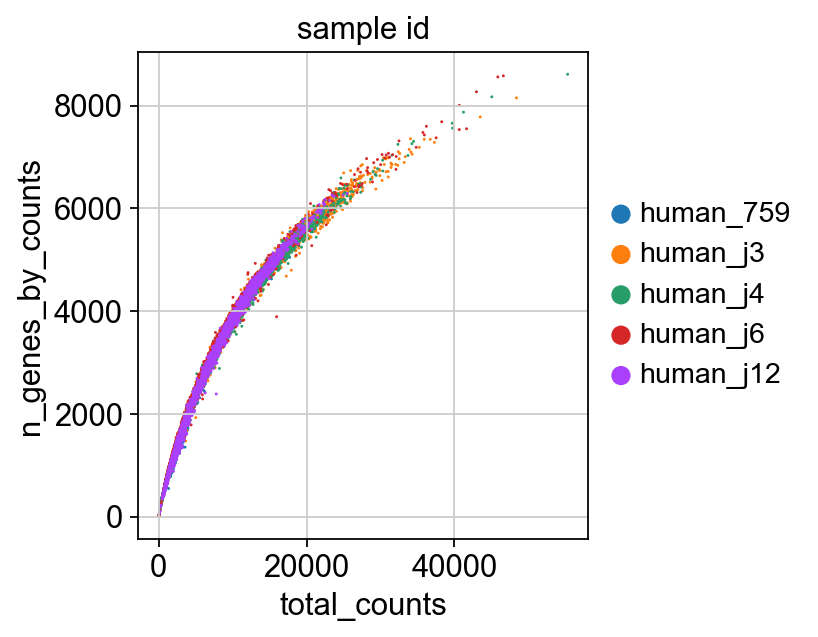

In [8]:
sc.pl.scatter(adata, x='pct_counts_ribo', y='pct_counts_mt', color="sample_id")
sc.pl.scatter(adata, x='total_counts', y='n_genes_by_counts', color="sample_id")

normalizing counts per cell
    finished (0:00:00)


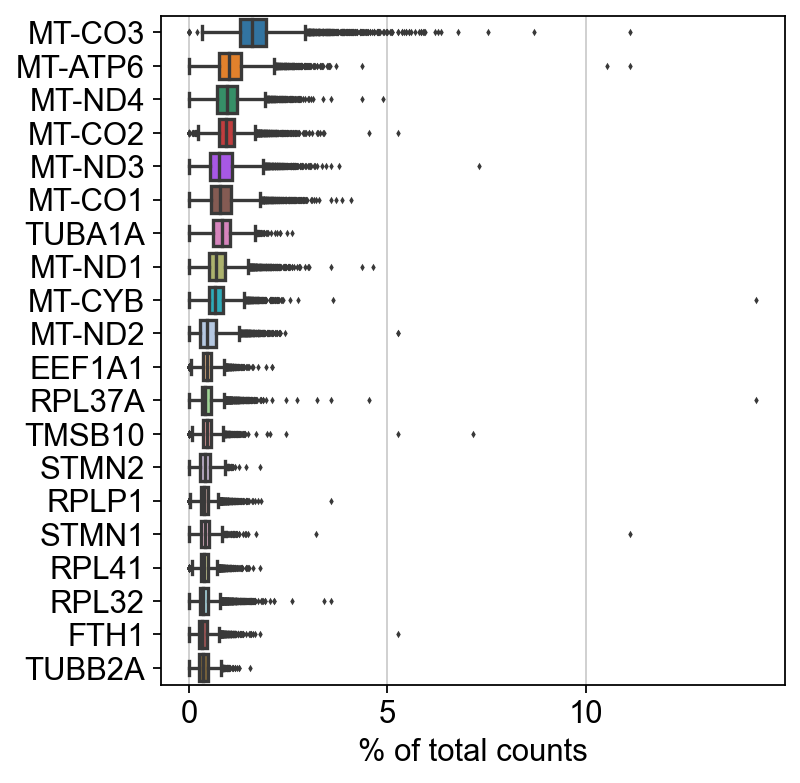

In [9]:
sc.pl.highest_expr_genes(adata, n_top=20)

# Поcмотрим на разметку

## Отрисуем разметку

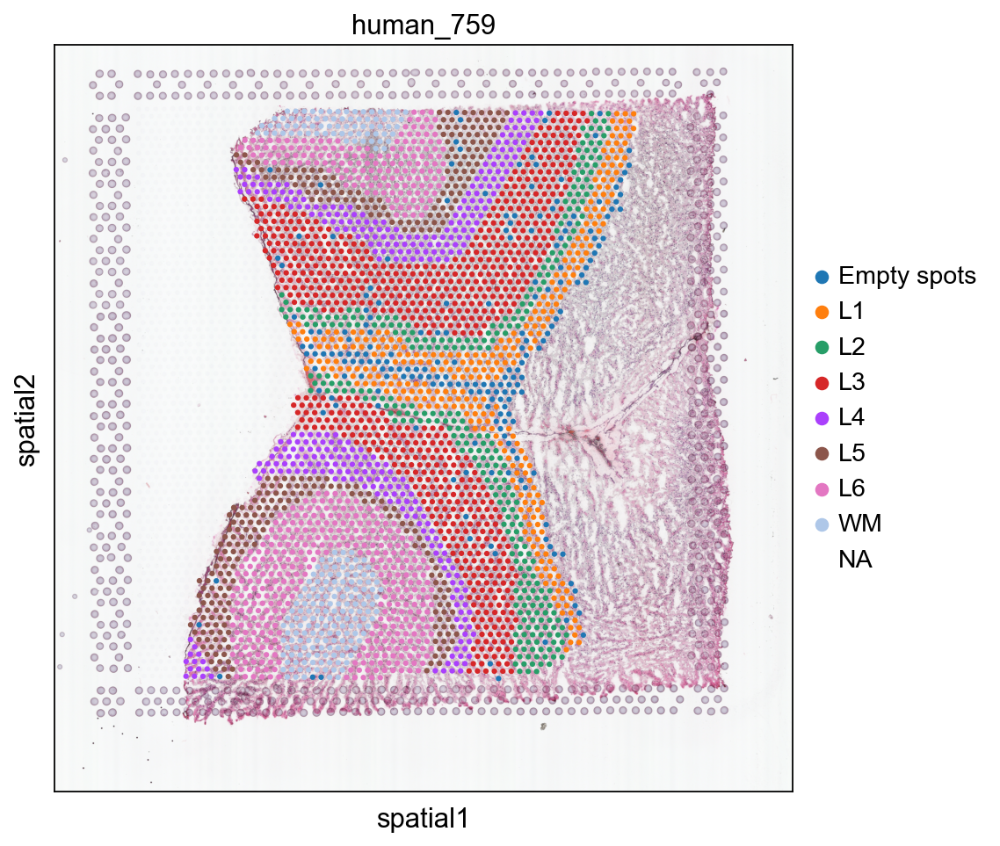

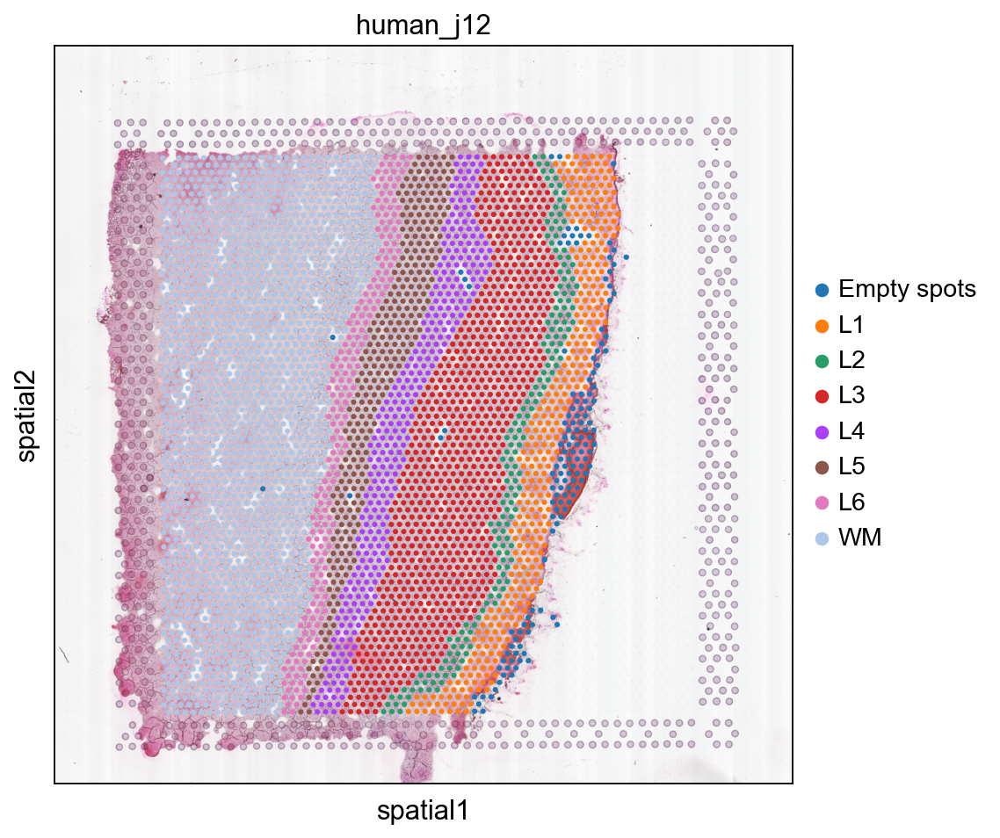

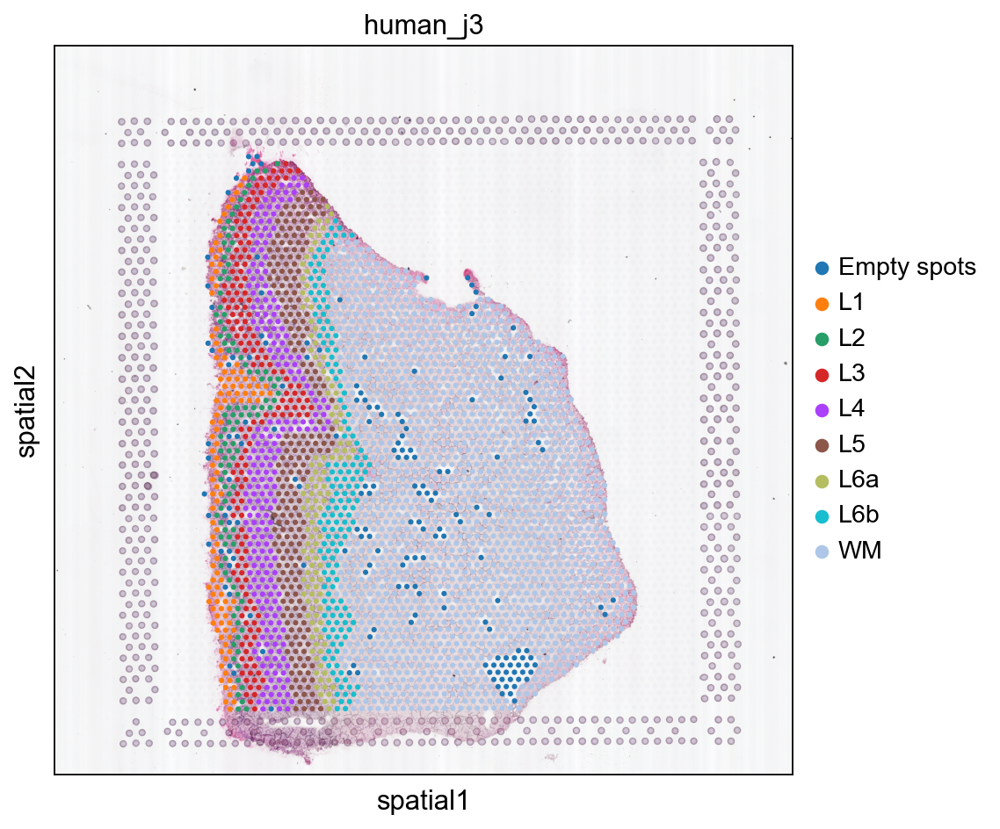

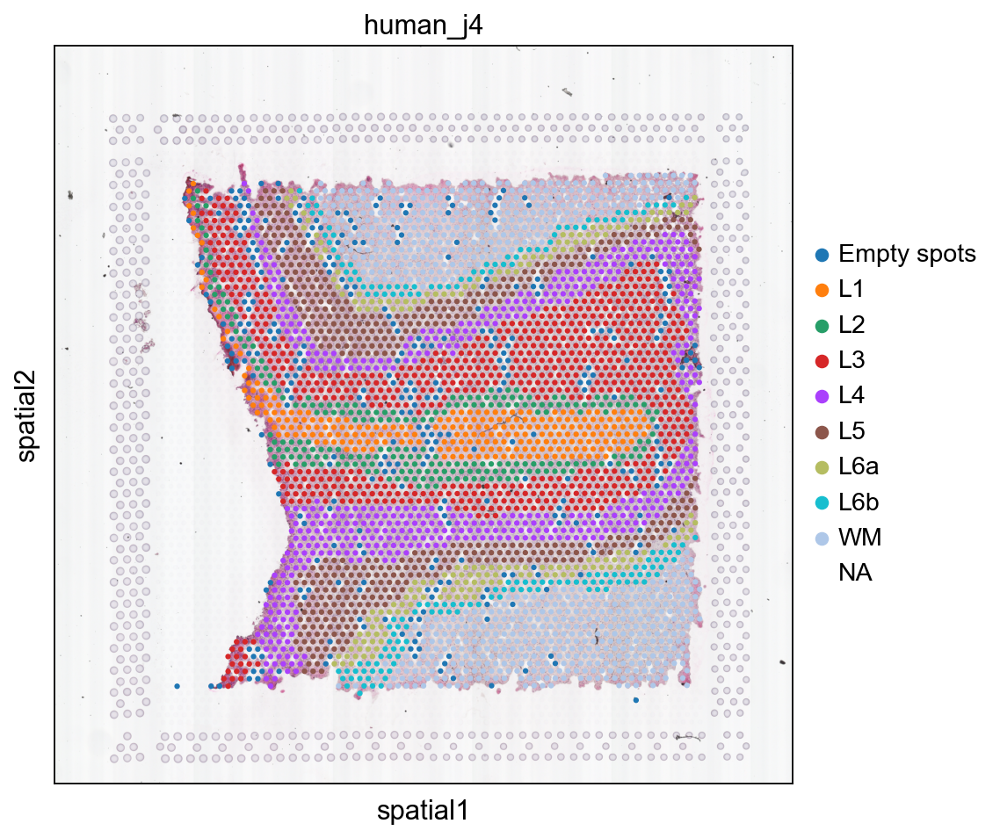

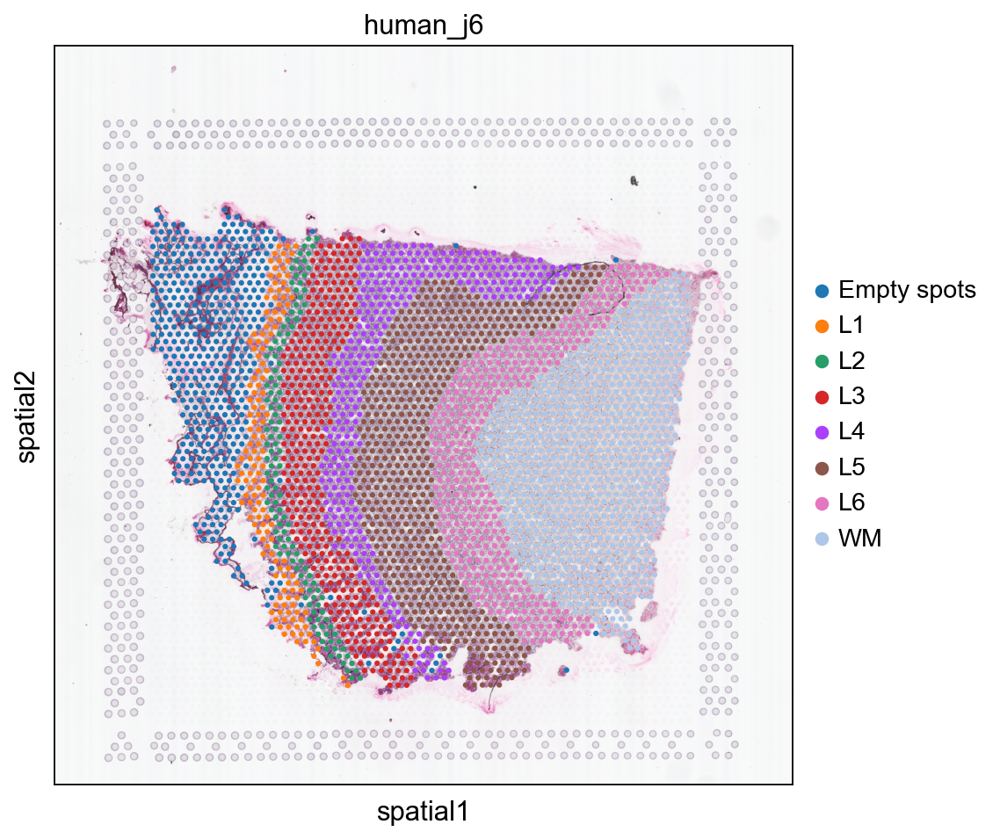

In [10]:
for sample in samples:
    sq.pl.spatial_scatter(adata, library_id=sample, library_key='sample_id', color="label", title=sample, figsize=(7, 7))

## Оставим только размеченные данные

In [11]:
human_labeled = adata[adata.obs.label.notna()].copy()

C:\Users\aleks\anaconda3\envs\scanorama39\lib\site-packages\anndata\_core\anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


## Посчитаем метрики

In [12]:
# add info on mitochondrial and hemoglobin genes to the objects.
human_labeled.var['mt'] = human_labeled.var_names.str.startswith('MT-')
human_labeled.var['hb'] = human_labeled.var_names.str.contains(("^HB[AB]"))
human_labeled.var['ribo'] = human_labeled.var_names.str.contains(("^RP[LS]"))

sc.pp.calculate_qc_metrics(
    human_labeled, qc_vars=['mt','hb','ribo'],
    percent_top=None, log1p=False, inplace=True)

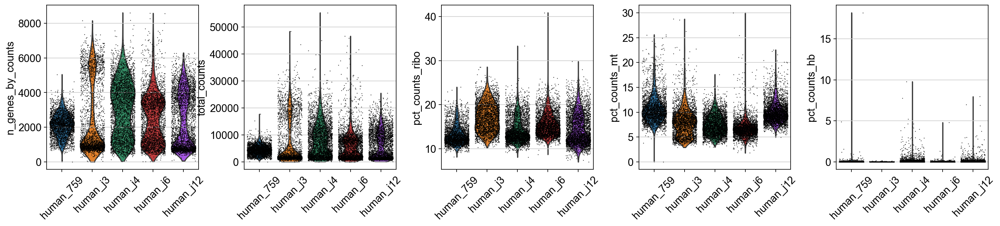

In [13]:
sc.pl.violin(human_labeled,
             keys = ['n_genes_by_counts', 'total_counts','pct_counts_ribo',
                     'pct_counts_mt', 'pct_counts_hb'],
             jitter=0.4, groupby = 'sample_id', rotation= 45, save='qc_labeled.png')

Заметим значительный уровень экспрессии митохондриальных генов

### Посмотрим на пространственное распределение 

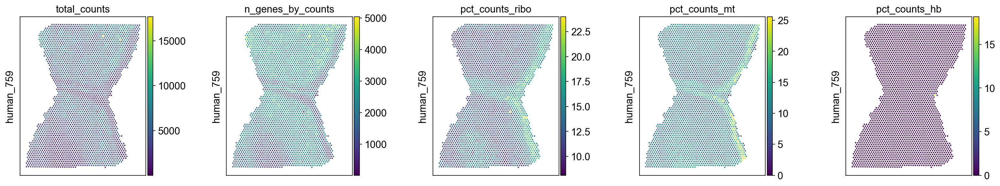

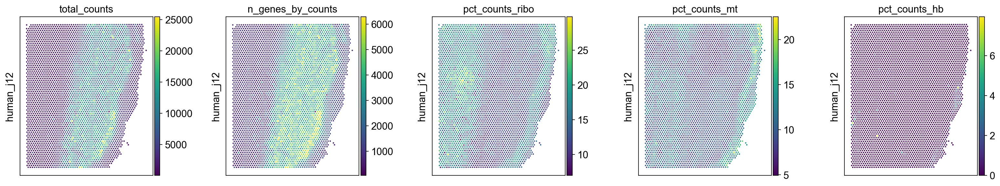

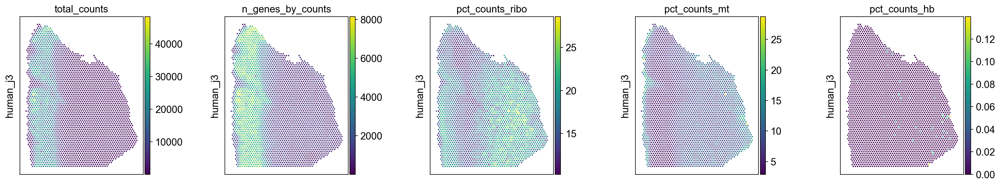

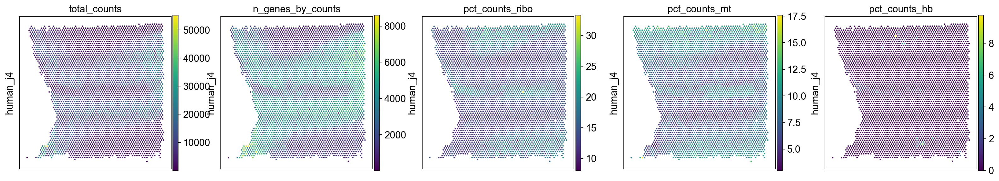

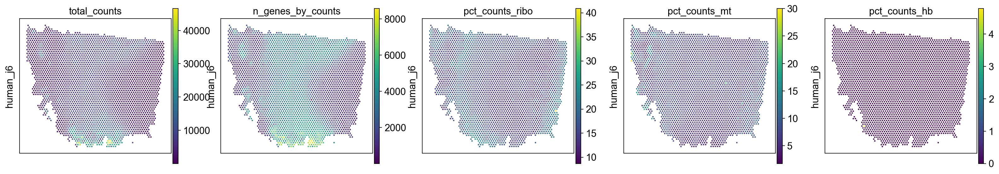

In [14]:
for sample in samples:
    sq.pl.spatial_scatter(human_labeled, library_id=sample, color = [
            'total_counts', 'n_genes_by_counts','pct_counts_ribo',
            'pct_counts_mt', 'pct_counts_hb'], ncols=5, library_key='sample_id',
        img=False, axis_label=['', sample])

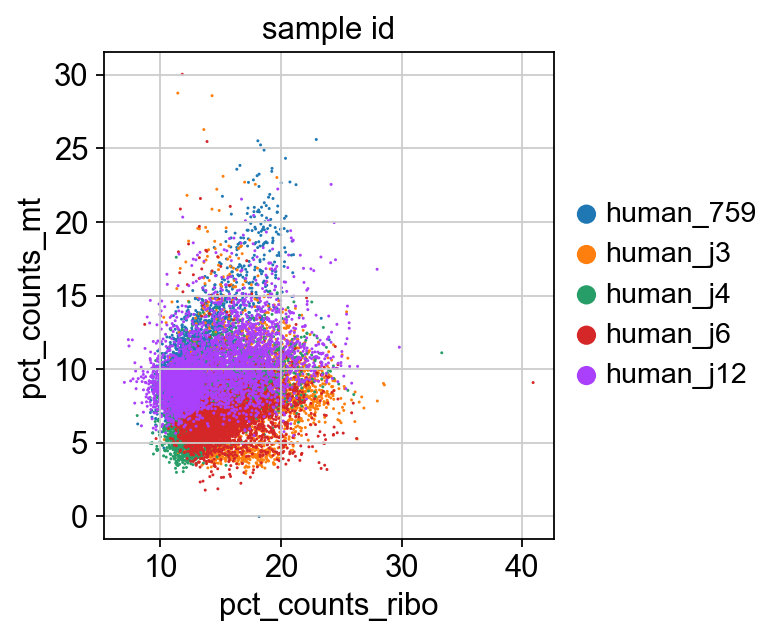

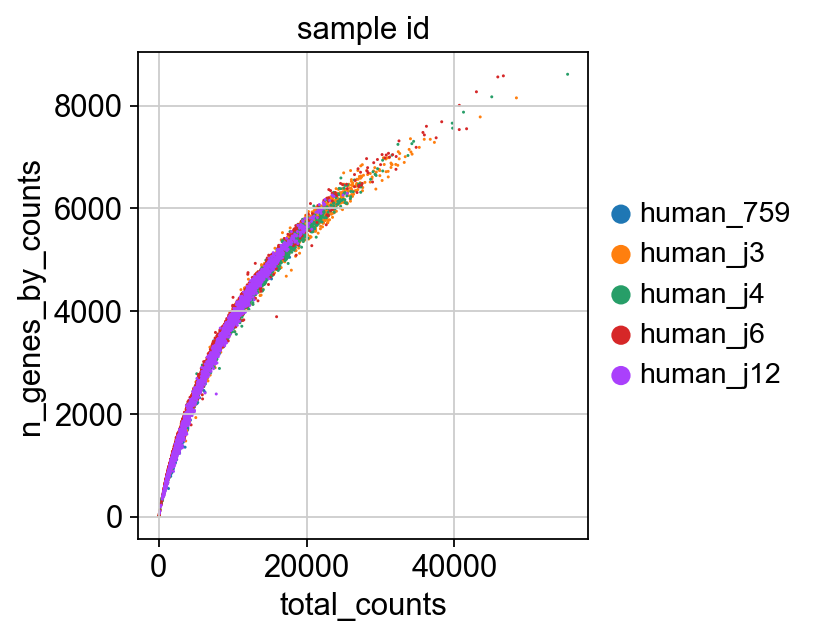

In [28]:
sc.pl.scatter(human_labeled, x='pct_counts_ribo', y='pct_counts_mt', color="sample_id")
sc.pl.scatter(human_labeled, x='total_counts', y='n_genes_by_counts', color="sample_id")

normalizing counts per cell
    finished (0:00:00)


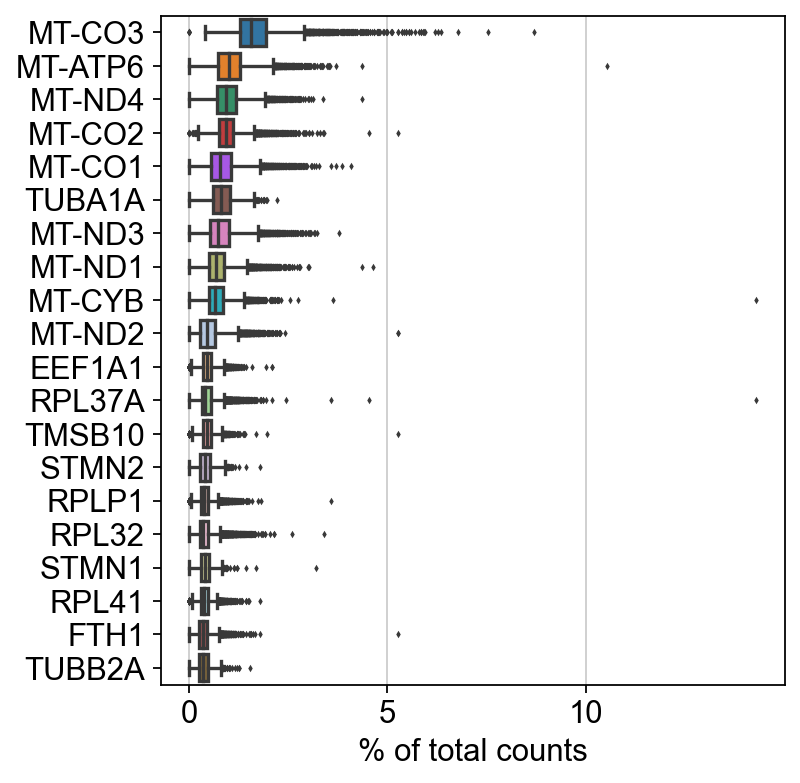

In [29]:
sc.pl.highest_expr_genes(human_labeled, n_top=20)

## Оставим только размеченные непустые данные

In [24]:
human_labeled_nonempty = adata[(adata.obs.label.notna()) & (adata.obs.label != 'Empty spots')].copy()

C:\Users\aleks\anaconda3\envs\scanorama39\lib\site-packages\anndata\_core\anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


## Посчитаем метрики

In [25]:
# add info on mitochondrial and hemoglobin genes to the objects.
human_labeled_nonempty.var['mt'] = human_labeled_nonempty.var_names.str.startswith('MT-')
human_labeled_nonempty.var['hb'] = human_labeled_nonempty.var_names.str.contains(("^HB[AB]"))
human_labeled_nonempty.var['ribo'] = human_labeled_nonempty.var_names.str.contains(("^RP[LS]"))

sc.pp.calculate_qc_metrics(
    human_labeled_nonempty, qc_vars=['mt','hb','ribo'],
    percent_top=None, log1p=False, inplace=True)

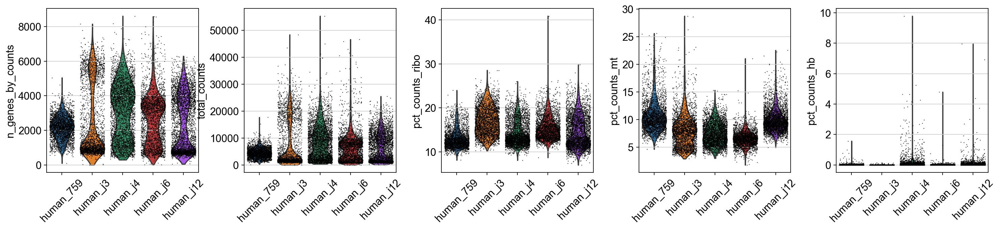

In [26]:
sc.pl.violin(human_labeled_nonempty,
             keys = ['n_genes_by_counts', 'total_counts','pct_counts_ribo',
                     'pct_counts_mt', 'pct_counts_hb'],
             jitter=0.4, groupby = 'sample_id', rotation= 45, save='qc_labeled_nonempty.png')

Заметим значительный уровень экспрессии митохондриальных генов

### Посмотрим на пространственное распределение 

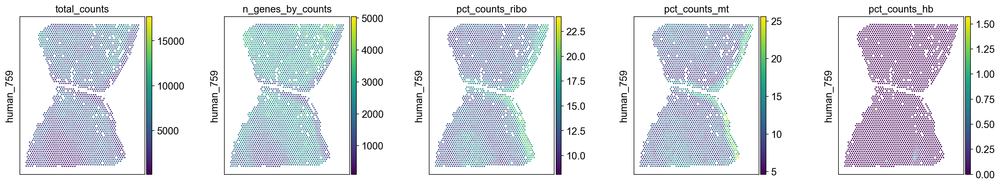

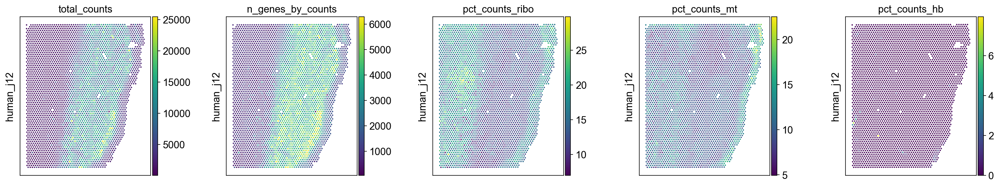

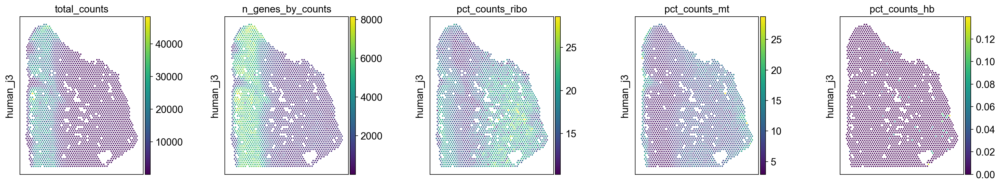

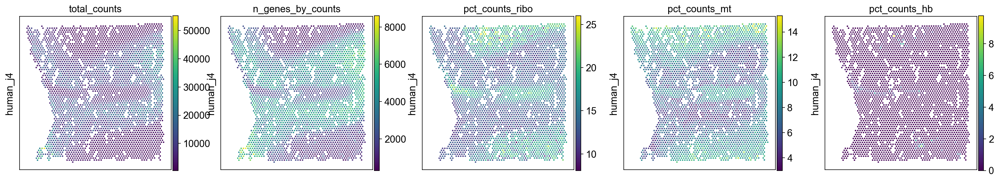

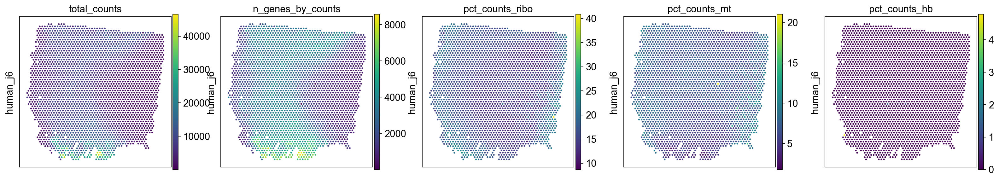

In [27]:
for sample in samples:
    sq.pl.spatial_scatter(human_labeled_nonempty, library_id=sample, color = [
            'total_counts', 'n_genes_by_counts','pct_counts_ribo',
            'pct_counts_mt', 'pct_counts_hb'], ncols=5, library_key='sample_id',
        img=False, axis_label=['', sample])

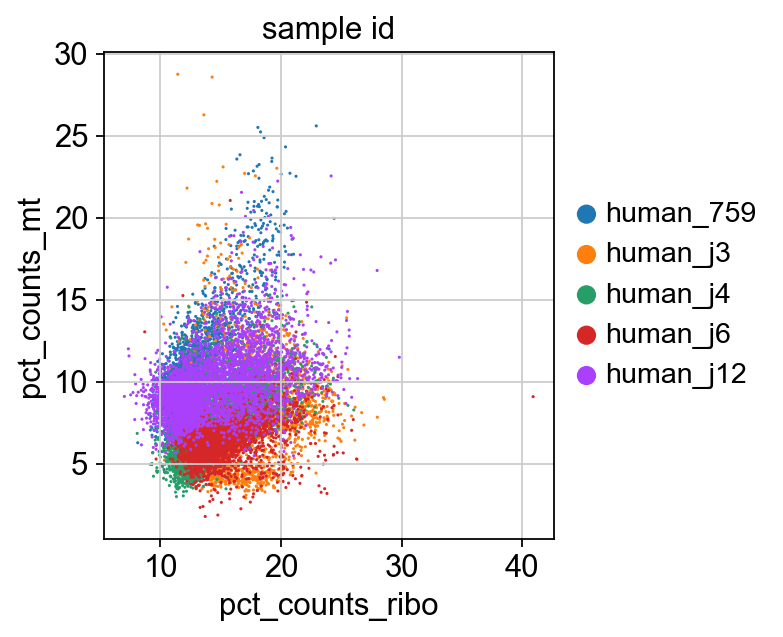

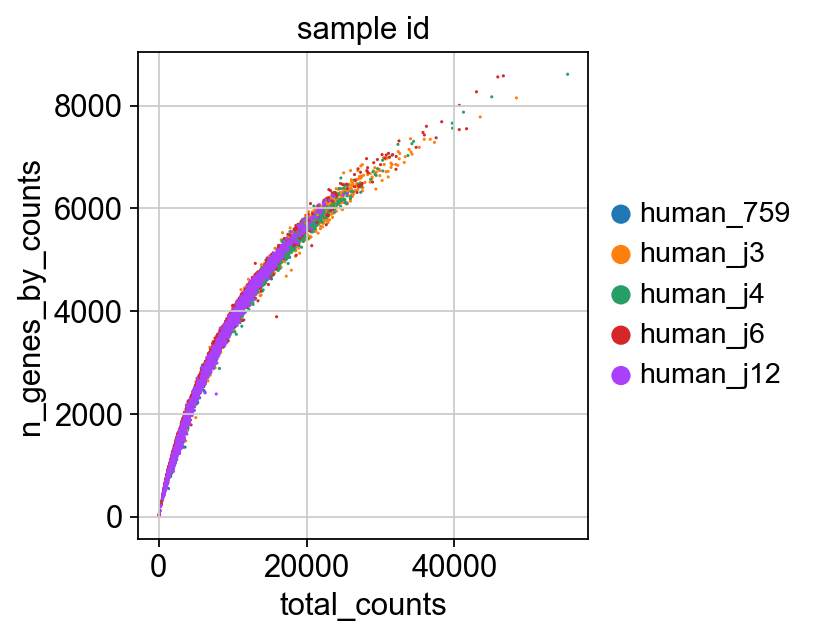

In [30]:
sc.pl.scatter(human_labeled_nonempty, x='pct_counts_ribo', y='pct_counts_mt', color="sample_id")
sc.pl.scatter(human_labeled_nonempty, x='total_counts', y='n_genes_by_counts', color="sample_id")

normalizing counts per cell
    finished (0:00:00)


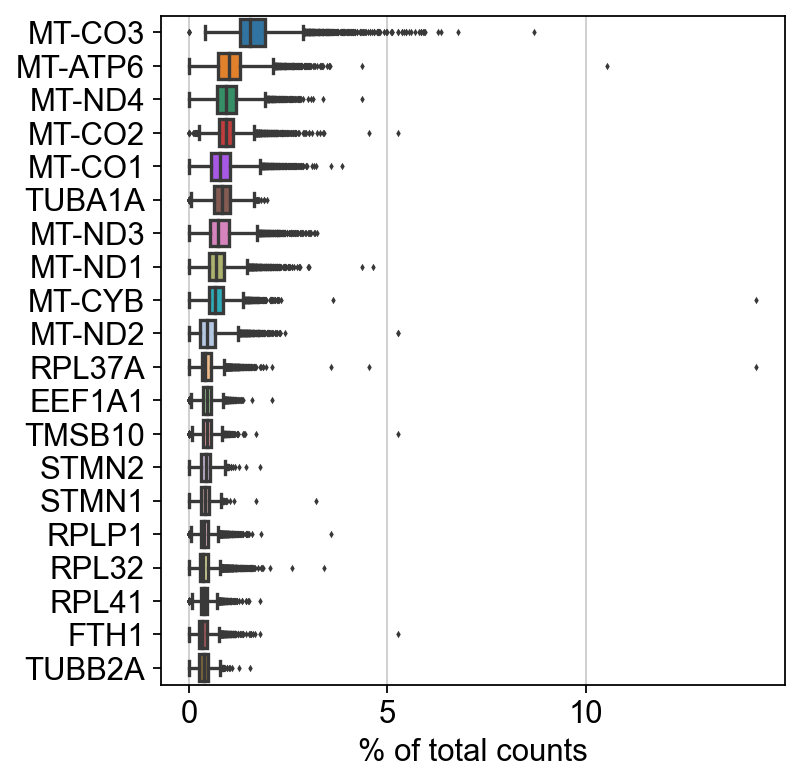

In [31]:
sc.pl.highest_expr_genes(human_labeled_nonempty, n_top=20)

# Дифф. экспрессия

In [53]:
remove = adata.var_names.str.startswith('MT-')
keep = np.invert(remove)
print(sum(remove))

adata = adata[:,keep]

13


In [55]:
sc.pp.normalize_total(adata, target_sum=1e4)
sc.pp.log1p(adata)

C:\Users\aleks\anaconda3\envs\scanorama39\lib\site-packages\scanpy\preprocessing\_normalization.py:170: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


normalizing counts per cell
    finished (0:00:00)


In [57]:
adata.obs['clusters'] = adata.obs.label
adata.obs.clusters.replace({'L6a': 'L6', 'L6b': 'L6'}, inplace=True)
adata.obs.clusters.unique()

[NaN, 'WM', 'L5', 'Empty spots', 'L1', 'L6', 'L3', 'L2', 'L4']
Categories (8, object): ['Empty spots', 'L1', 'L2', 'L3', 'L4', 'L5', 'L6', 'WM']

In [58]:
sc.tl.rank_genes_groups(adata, groupby='clusters', method='t-test')

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:05)


         Falling back to preprocessing with `sc.pp.pca` and default params.
computing PCA
    with n_comps=50
    finished (0:02:28)
Storing dendrogram info using `.uns['dendrogram_clusters']`


C:\Users\aleks\anaconda3\envs\scanorama39\lib\site-packages\scanpy\plotting\_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


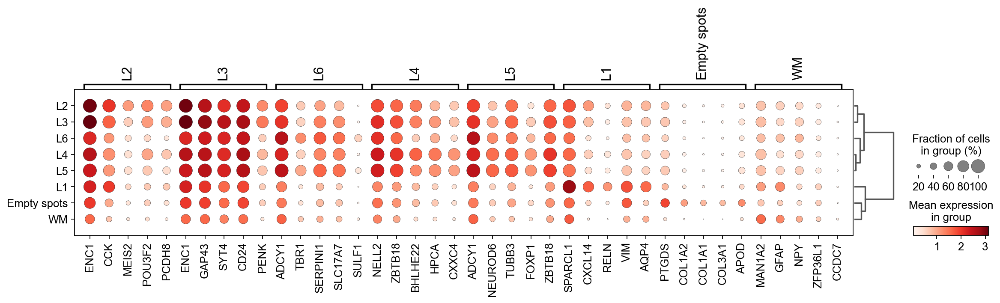

In [59]:
sc.pl.rank_genes_groups_dotplot(
    adata, n_genes=5, groupby="clusters", min_logfoldchange=1)